In [6]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

from IPython.display import HTML
from torch.utils.data import Subset

In [7]:
# Fix the random seed for reproducibility

use_random_seed = False # Set to False for reproducible results
seed = random.randint(1, 10000) if use_random_seed else 999

random.seed(seed)
torch.manual_seed(seed)
torch.use_deterministic_algorithms(not use_random_seed)

In [8]:
# Fixed parameters

dataset_directory = "animals"
animal = "spider" # should be a subdirectory
dataloader_workers = 2
image_size = 64
training_channels = 3 # RGB

generator_size = 100 # aka latent vector
gfms = 64 # generator features' map size
dfms = 64 # discriminator features' map size

In [9]:
# Hyperparameters for training

batch_size = 64
num_epochs = 20
learning_rate = 0.0002
beta1 = 0.5 # Adam optimizers

In [10]:
# Make sure we have a GPU

assert torch.cuda.is_available(), "GPU not available"
device = torch.device("cuda:0")

In [11]:
# Load the dataset

dataset = dset.ImageFolder(
    root=dataset_directory,
    transform=transforms.Compose(
        [
            transforms.Resize(image_size),
            transforms.CenterCrop(image_size),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ]
    ),
)

# Subset containing only the given animal
animal_indices = [
    i for i in range(len(dataset)) 
    if dataset.imgs[i][1] == dataset.class_to_idx[animal]
]
subset = Subset(dataset, animal_indices)

dataloader = torch.utils.data.DataLoader(
    subset, 
    batch_size=batch_size, 
    shuffle=True, 
    num_workers=dataloader_workers
)

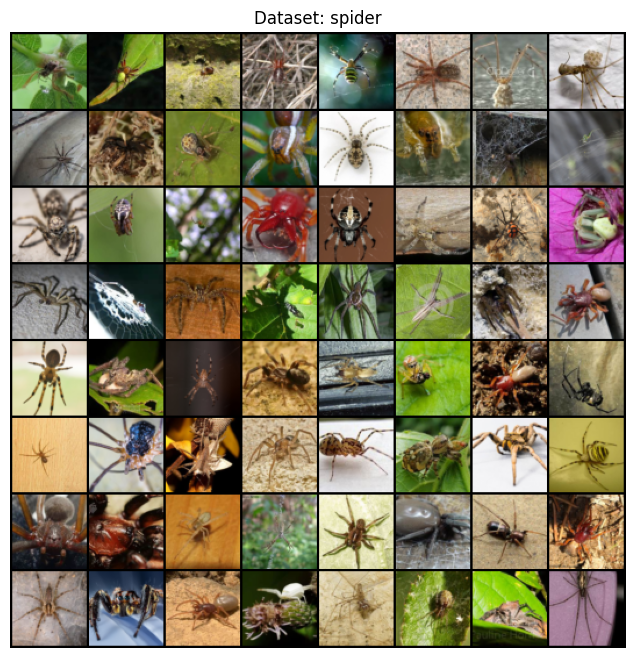

In [12]:
# Display some examples from the dataset

batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Dataset: {animal}")
plt.imshow(
    np.transpose(
        vutils.make_grid(batch[0].to(device)[:64], padding=2, normalize=True).cpu(),
        (1, 2, 0),
    )
)

In [13]:
# Define the generator

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(generator_size, gfms * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(gfms * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(gfms * 8, gfms * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(gfms * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(gfms * 4, gfms * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(gfms * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(gfms * 2, gfms, 4, 2, 1, bias=False),
            nn.BatchNorm2d(gfms),
            nn.ReLU(True),
            nn.ConvTranspose2d(gfms, training_channels, 4, 2, 1, bias=False),
            nn.Tanh(),
        )
        self.to(device)

    def forward(self, input):
        return self.main(input)


In [14]:
# Define the discriminator

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(training_channels, dfms, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(dfms, dfms * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(dfms * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(dfms * 2, dfms * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(dfms * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(dfms * 4, dfms * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(dfms * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(dfms * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
        self.to(device)

    def forward(self, input):
        return self.main(input)

In [15]:
# Instantiate the networks and initialize the weights

def initialize_weights(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

netG = Generator()
netD = Discriminator()

netG.apply(initialize_weights);
netD.apply(initialize_weights);

# Optional visualization with pretrained parameters

In [16]:
# Load pretrained weights

netG.load_state_dict(torch.load("weights/base/netG-100ep.pt"));
netD.load_state_dict(torch.load("weights/base/netD-100ep.pt"));

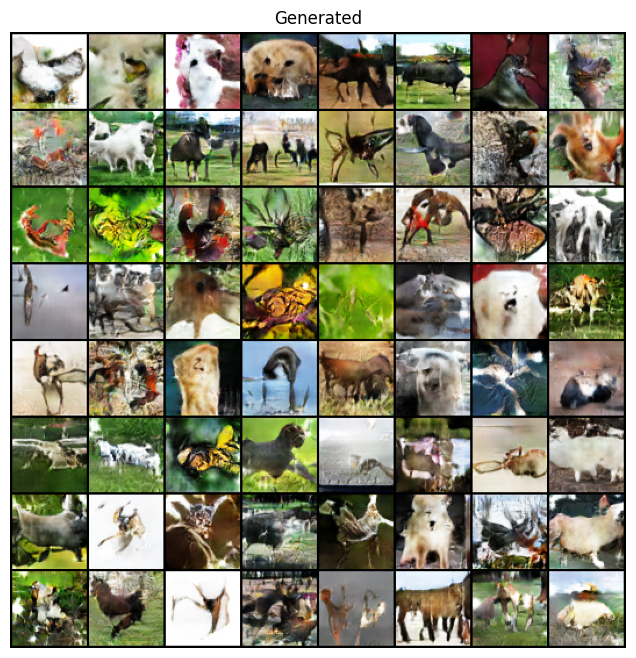

In [17]:
# Print some examples

latent_vectors = torch.randn(64, generator_size, 1, 1, device=device)

batch = netG(latent_vectors).detach().cpu()
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Generated")
plt.imshow(
    np.transpose(
        vutils.make_grid(batch, padding=2, normalize=True).cpu(),
        (1, 2, 0),
    )
)

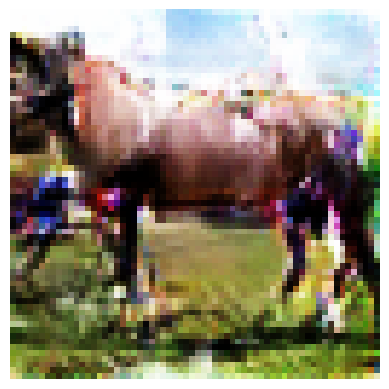

In [281]:
# Print a single image
def normalize(vector):
    n = vector - np.min(vector)
    n = n / np.max(n)
    return n

latent_vector = torch.randn(1, generator_size, 1, 1, device=device)
image = netG(latent_vector).detach().cpu().numpy()[0]
image = normalize(image)

figure = plt.figure()
plt.axis("off")
plt.imshow(np.transpose(image, (1,2,0)))

In [282]:
# Animation of moving latent vector
# Generate the latent vectors

def next_(vector, epsilon):
    """
    Moves the latent vector by epsilon.
    Reverse the direction if 0 or 1 is reached.
    """
    ceros = np.where(vector < 0.01)
    ones = np.where(vector > 0.99)
    epsilon[ceros] = -epsilon[ceros]
    epsilon[ones] = -epsilon[ones]
    return vector + epsilon

frames_count = 1000
epsilon = (np.random.rand(100) - 0.5) * 0.01
base = np.random.rand(100)
latent_vectors = np.array([base])

for i in range(frames_count - 1):
    new_vector = next_(latent_vectors[-1], epsilon)
    latent_vectors = np.vstack((latent_vectors, new_vector))

latent_vectors = latent_vectors.reshape(frames_count, 100, 1, 1)
latent_vectors = torch.from_numpy(latent_vectors).to(device=device, dtype=torch.float)

In [284]:
# Generate the frames for each latent vector and display the animation

images = netG(latent_vectors).detach().cpu().numpy()
figure = plt.figure()
plt.axis("off")
frames = [[plt.imshow(normalize(np.transpose(image, (1,2,0))))] for image in images]
animated_frames = animation.ArtistAnimation(figure, frames, interval=50, repeat_delay=1000, blit=True)
plt.close()
HTML(animated_frames.to_jshtml())

Animation size has reached 20978863 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# Jump here for training!

In [23]:
# Modify hyperparameters for training?

batch_size = 64
num_epochs = 100
learning_rate = 0.0002
beta1 = 0.5 # Adam optimizers

In [24]:
# Train the network
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
# the progression of the generator
fixed_noise = torch.randn(64, generator_size, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label, fake_label = 1., 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=learning_rate, betas=(beta1, 0.999))

In [25]:
# Train and keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, generator_size, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

[0/100][0/76]	Loss_D: 0.2567	Loss_G: 10.3942	D(x): 0.9980	D(G(z)): 0.1729 / 0.0001
[0/100][50/76]	Loss_D: 0.2745	Loss_G: 7.3031	D(x): 0.9924	D(G(z)): 0.1210 / 0.0066
[1/100][0/76]	Loss_D: 0.0319	Loss_G: 5.8284	D(x): 0.9980	D(G(z)): 0.0277 / 0.0102
[1/100][50/76]	Loss_D: 0.0192	Loss_G: 7.6542	D(x): 0.9977	D(G(z)): 0.0137 / 0.0034
[2/100][0/76]	Loss_D: 0.0172	Loss_G: 6.4881	D(x): 0.9980	D(G(z)): 0.0146 / 0.0054
[2/100][50/76]	Loss_D: 0.0097	Loss_G: 7.0602	D(x): 0.9933	D(G(z)): 0.0029 / 0.0029
[3/100][0/76]	Loss_D: 0.7505	Loss_G: 1.6066	D(x): 0.6276	D(G(z)): 0.0808 / 0.3364
[3/100][50/76]	Loss_D: 0.0746	Loss_G: 7.2925	D(x): 0.9449	D(G(z)): 0.0102 / 0.0058
[4/100][0/76]	Loss_D: 0.0536	Loss_G: 7.5686	D(x): 0.9723	D(G(z)): 0.0163 / 0.0035
[4/100][50/76]	Loss_D: 0.1696	Loss_G: 7.6497	D(x): 0.9997	D(G(z)): 0.0999 / 0.0017
[5/100][0/76]	Loss_D: 0.1745	Loss_G: 7.0933	D(x): 0.9994	D(G(z)): 0.1296 / 0.0025
[5/100][50/76]	Loss_D: 0.0406	Loss_G: 7.7754	D(x): 0.9983	D(G(z)): 0.0350 / 0.0020
[6/100][0

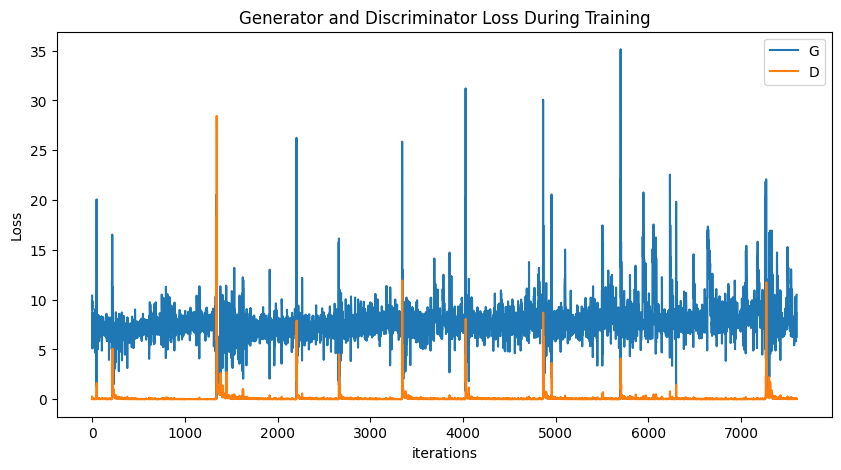

In [26]:
# Display the progress of the loss
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [ ]:
# Progress over the fixed noise

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
plt.close()
HTML(ani.to_jshtml())

In [298]:
# Save model weights

torch.save(netG.state_dict(), "weights/spider/netG-20ep.pt")
torch.save(netD.state_dict(), "weights/spider/netD-20ep.pt")